# Assignment 3

This code is influenced by Zhang. Thanks to Professor Hanumant Singh for providing with the code.

And I have collaborated to discuss the logics with Yogeshwaran Easwaran

In [1]:
pip install gtsam

In [2]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import math
import glob
import gtsam
import gtsam.utils.plot
import os
import itertools

In [3]:
def ReadImage(ImageFolderPath):
    Images = []
    if os.path.isdir(ImageFolderPath):
        ImageNames = os.listdir(ImageFolderPath)
        ImageNames_Split = [[int(os.path.splitext(os.path.basename(ImageName))[0]), ImageName] for ImageName in ImageNames]
        ImageNames_Split = sorted(ImageNames_Split, key=lambda x:x[0])
        ImageNames_Sorted = [ImageNames_Split[i][1] for i in range(len(ImageNames_Split))]
        for i in range(len(ImageNames_Sorted)):
            ImageName = ImageNames_Sorted[i]
            InputImage = cv2.imread(ImageFolderPath + "/" + ImageName)
            if InputImage is None:
                print("Not able to read image: {}".format(ImageName))
                exit(0)
            Images.append(InputImage)
    return Images

In [26]:
Images = ReadImage("/content/sample_data/Images_6/")
print(len(Images))

6


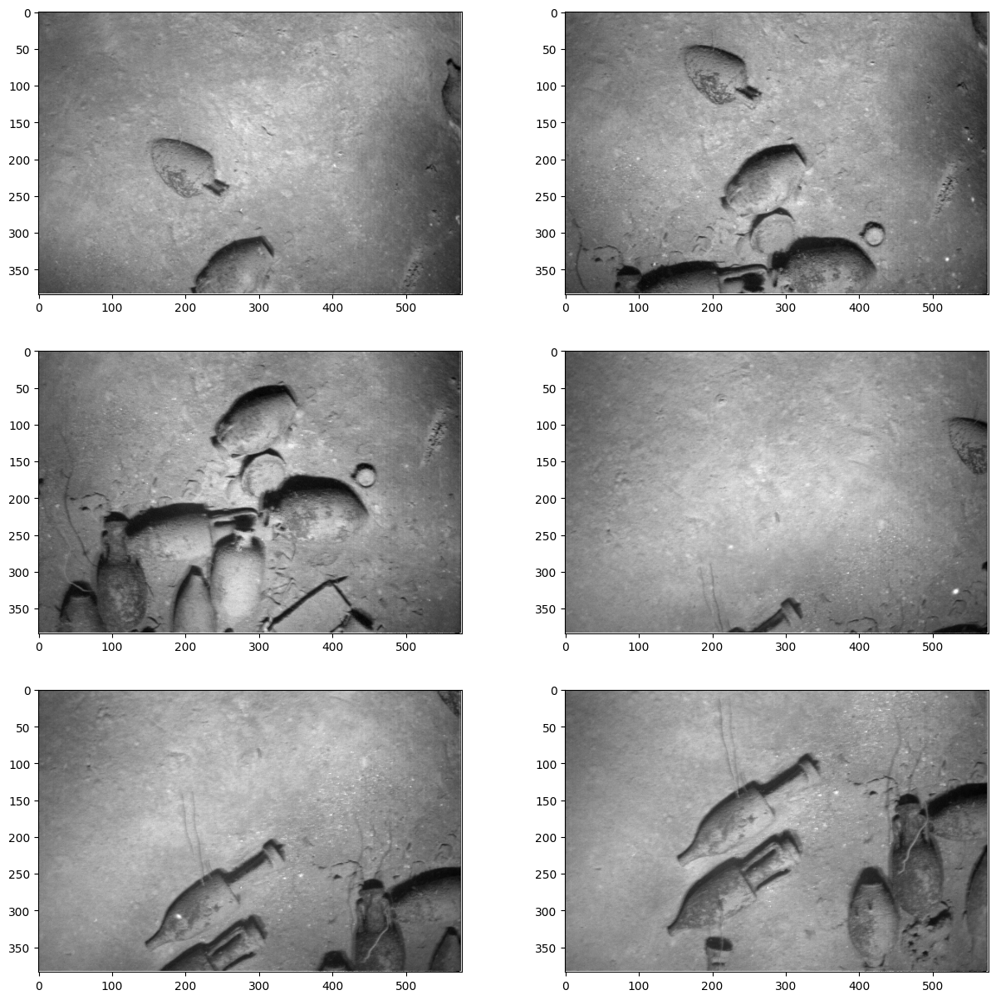

In [4]:
fig = plt.figure(figsize=(15,15))
i=1
for image in range(len(Images)):
    fig.add_subplot(math.ceil(len(Images)/2), 2,i)
    plt.imshow(Images[image])
    i+=1

In [4]:
def FindMatches(Image1, Image2, flag = False):
  if flag == False:
      Sift = cv2.SIFT_create()
      Image1Keypoints, Image1Descriptors = Sift.detectAndCompute(cv2.cvtColor(Image1, cv2.COLOR_BGR2GRAY), None)
      Image2Keypoints, Image2Descriptors = Sift.detectAndCompute(cv2.cvtColor(Image2, cv2.COLOR_BGR2GRAY), None)

      BF_Matcher = cv2.BFMatcher()
      InitialMatches = BF_Matcher.knnMatch(Image1Descriptors, Image2Descriptors, k=2)

      GoodMatches = []

      for m, n in InitialMatches:
          if m.distance < 0.75 * n.distance:
              GoodMatches.append([m])

      img3 = cv2.drawMatchesKnn(Image1,Image1Keypoints,Image2,Image2Keypoints,GoodMatches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

      plt.imshow(img3), plt.show()
      return GoodMatches, Image1Keypoints, Image2Keypoints
      # cv2.imwrite('Matches.jpg', img3)

  elif flag == True:
    keypoints = Image1
    descriptors = Image2

    matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

    keypoint_matches = []
    matches = []

    for idx in range(len(keypoints)):
            current_descriptors = descriptors[idx]
            next_descriptors = descriptors[(idx + 1) % len(keypoints)]

            GoodMatches = matcher.knnMatch(next_descriptors, current_descriptors, k=2)

            mask = np.zeros((current_descriptors.shape[0], next_descriptors.shape[0]), dtype='uint8')

            filtered_matches = []

            for match in GoodMatches:
                if len(match) == 1 or (len(match) > 1 and match[0].distance < 0.90 * match[1].distance):
                    filtered_matches.append(match[0])
                    mask[match[0].trainIdx, match[0].queryIdx] = 1

            final_matches = matcher.match(current_descriptors, next_descriptors, mask=mask)
            matches.append(final_matches)

            keypoints_1_matches = np.array([keypoints[idx][match.queryIdx].pt for match in final_matches])
            keypoints_2_matches = np.array([keypoints[(idx + 1) % len(keypoints)][match.trainIdx].pt for match in final_matches])

            keypoints.append((keypoints_1_matches, keypoints_2_matches))

    return matches, keypoints

In [5]:
def compute_homography(matches=[], base_kp=[], sec_kp=[], flag=True, keypoint_matches=[]):
    if flag:
        # Check if we have enough matches to compute homography
        if len(matches) < 4:
            print("\nError: Insufficient matches to compute homography.\n")
            return None, None

        # Extract corresponding points from both images based on matches
        base_image_pts = np.float32([base_kp[match[0].queryIdx].pt for match in matches])
        sec_image_pts = np.float32([sec_kp[match[0].trainIdx].pt for match in matches])

        # Compute the homography matrix using RANSAC method
        homography_matrix, status = cv2.findHomography(sec_image_pts, base_image_pts, cv2.RANSAC, 5.0)
        return homography_matrix, status

    else:
        global img1_points_list,img2_points_list
        img1_points_list = []
        img2_points_list = []

        for kp_pair in keypoint_matches:
            img1_points_list.append(np.float32(kp_pair[0]))
            img2_points_list.append(np.float32(kp_pair[1]))

        homographies = []
        statuses = []

        for i in range(len(img1_points_list)):
            h_matrix, mask = cv2.findHomography(img2_points_list[i], img1_points_list[i], cv2.RANSAC, 1.0)
            homographies.append(h_matrix)
            statuses.append(mask)

        return homographies, statuses


In [6]:
def calculate_canvas(h_matrix, sec_img_shape, base_img_shape):
    sec_height, sec_width = sec_img_shape

    sec_corners = np.array([[0, sec_width, sec_width, 0],
                            [0, 0, sec_height, sec_height],
                            [1, 1, 1, 1]])

    transformed_corners = np.dot(h_matrix, sec_corners)

    # Normalize the coordinates by dividing by the last row
    x_coords = transformed_corners[0] / transformed_corners[2]
    y_coords = transformed_corners[1] / transformed_corners[2]

    min_x, max_x = int(np.floor(x_coords.min())), int(np.ceil(x_coords.max()))
    min_y, max_y = int(np.floor(y_coords.min())), int(np.ceil(y_coords.max()))

    updated_width = max_x
    updated_height = max_y
    translation = [0, 0]  # Offsets for any negative coordinates

    # Adjust the canvas width and translation offset if necessary
    if min_x < 0:
        translation[0] = -min_x
        updated_width += translation[0]

    if min_y < 0:
        translation[1] = -min_y
        updated_height += translation[1]

    updated_width = max(updated_width, base_img_shape[1] + translation[0])
    updated_height = max(updated_height, base_img_shape[0] + translation[1])

    x_coords += translation[0]
    y_coords += translation[1]

    sec_original_corners = np.float32([[0, 0],
                                       [sec_width, 0],
                                       [sec_width, sec_height],
                                       [0, sec_height]])

    sec_transformed_corners = np.float32(np.vstack([x_coords, y_coords]).T)

    adjusted_h_matrix = cv2.getPerspectiveTransform(sec_original_corners, sec_transformed_corners)

    return [updated_height, updated_width], translation, adjusted_h_matrix


In [7]:
def stitch_images(base_image, sec_image):
    # Apply cylindrical transformation to the secondary image and retrieve mask
    sec_image_cylindrical, mask_x, mask_y = apply_transformations(sec_image)

    # Create a mask for the transformed secondary image
    sec_image_mask = np.zeros_like(sec_image_cylindrical, dtype=np.uint8)
    sec_image_mask[mask_y, mask_x, :] = 255

    # Find keypoint matches between the base and transformed secondary images
    matches, base_image_keypoints, sec_image_keypoints = FindMatches(base_image, sec_image_cylindrical)

    # Compute the homography matrix between the images
    homography_matrix, status = compute_homography(matches, base_image_keypoints, sec_image_keypoints)

    # Determine the size of the new canvas and correct the homography matrix
    new_frame_size, offset, homography_matrix = calculate_canvas(homography_matrix, sec_image_cylindrical.shape[:2], base_image.shape[:2])

    # Warp the transformed secondary image to fit the new canvas size
    transformed_sec_image = cv2.warpPerspective(sec_image_cylindrical, homography_matrix, (new_frame_size[1], new_frame_size[0]))

    # Warp the mask of the secondary image similarly
    transformed_sec_image_mask = cv2.warpPerspective(sec_image_mask, homography_matrix, (new_frame_size[1], new_frame_size[0]))

    # Initialize a new empty canvas for the base image and place it on the corrected frame
    transformed_base_image = np.zeros((new_frame_size[0], new_frame_size[1], 3), dtype=np.uint8)
    transformed_base_image[offset[1]:offset[1]+base_image.shape[0], offset[0]:offset[0]+base_image.shape[1]] = base_image

    # Combine the two images, taking into account the transformed mask
    stitched_image = cv2.bitwise_or(transformed_sec_image, cv2.bitwise_and(transformed_base_image, cv2.bitwise_not(transformed_sec_image_mask)))

    return stitched_image


In [8]:
def apply_transformations(image):
    height, width = image.shape[:2]
    center_x, center_y = width // 2, height // 2
    f = 1100  # Focal length

    # Initialize the transformed image
    transformed_image = np.zeros_like(image, dtype=np.uint8)

    # Create grid of pixel coordinates
    x_coords, y_coords = np.meshgrid(np.arange(width), np.arange(height))
    x_coords = x_coords.flatten()
    y_coords = y_coords.flatten()

    # Perform cylindrical transformation
    cyl_x = (f * np.tan((x_coords - center_x) / f)) + center_x
    cyl_y = ((y_coords - center_y) / np.cos((x_coords - center_x) / f)) + center_y

    # Convert transformed coordinates to integers for indexing
    cyl_x_int = cyl_x.astype(int)
    cyl_y_int = cyl_y.astype(int)

    # Filter valid coordinates that lie within image bounds
    valid_coords = (cyl_x_int >= 0) & (cyl_x_int < width - 1) & (cyl_y_int >= 0) & (cyl_y_int < height - 1)

    x_coords = x_coords[valid_coords]
    y_coords = y_coords[valid_coords]
    cyl_x = cyl_x[valid_coords]
    cyl_y = cyl_y[valid_coords]
    cyl_x_int = cyl_x_int[valid_coords]
    cyl_y_int = cyl_y_int[valid_coords]

    # Calculate bilinear interpolation weights
    dx = cyl_x - cyl_x_int
    dy = cyl_y - cyl_y_int
    weight_tl = (1 - dx) * (1 - dy)
    weight_tr = dx * (1 - dy)
    weight_bl = (1 - dx) * dy
    weight_br = dx * dy

    # Perform bilinear interpolation and update transformed image
    transformed_image[y_coords, x_coords] = (
        weight_tl[:, None] * image[cyl_y_int, cyl_x_int] +
        weight_tr[:, None] * image[cyl_y_int, cyl_x_int + 1] +
        weight_bl[:, None] * image[cyl_y_int + 1, cyl_x_int] +
        weight_br[:, None] * image[cyl_y_int + 1, cyl_x_int + 1]
    )

    # Remove empty padding and crop the transformed image
    min_x = np.min(x_coords)
    cropped_transformed_image = transformed_image[:, min_x:width - min_x]

    # Return the transformed image and valid x/y coordinates
    return cropped_transformed_image, x_coords - min_x, y_coords

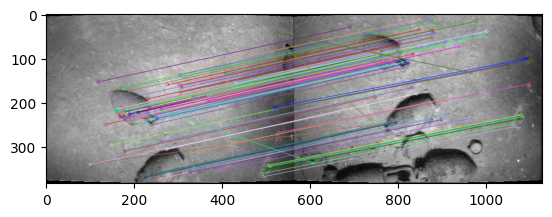

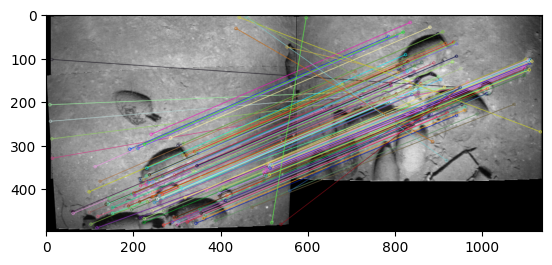

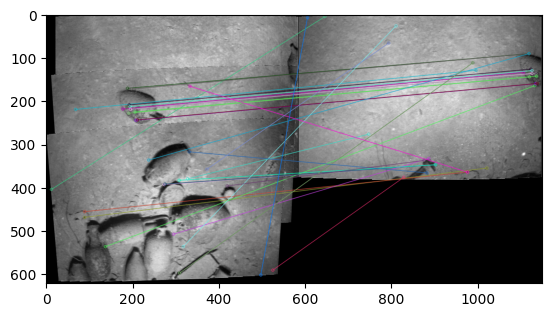

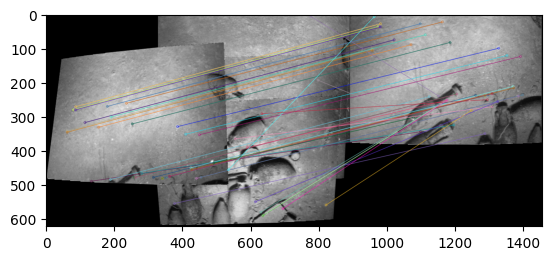

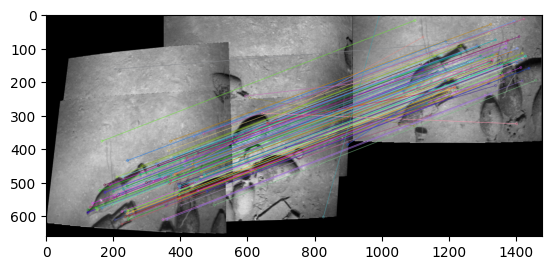

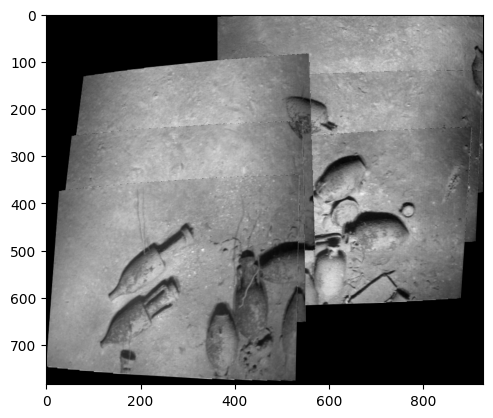

In [10]:
BaseImage, _, _ = apply_transformations(Images[0])
for i in range(1, len(Images)):
    StitchedImage = stitch_images(BaseImage, Images[i])

    BaseImage = StitchedImage.copy()
plt.figure()
plt.imshow(BaseImage)

In [27]:
NormalizedImages = [cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX) for img in Images]
grayImages = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in NormalizedImages]
im_h, im_w = grayImages[0].shape
sift = cv2.SIFT_create(nfeatures=5000, nOctaveLayers=12, contrastThreshold=0.025, sigma=1.25)

In [28]:
# Initialize lists for storing keypoints, descriptors, and images with keypoints
keypoints, descriptors, images_with_kpts = [], [], []

for gray_img in grayImages:
    # Detect keypoints and descriptors using SIFT
    kpts, descs = sift.detectAndCompute(gray_img, None)

    # Sort keypoints based on their response in descending order
    sorted_kpts = sorted(kpts, key=lambda x: -x.response)

    # Create a mask to track already occupied keypoints on a blank image
    mask_img = np.zeros_like(gray_img, dtype=np.uint8)
    selected_kpts, selected_descs = [], []

    # Filter out overlapping keypoints
    for idx, keypoint in enumerate(sorted_kpts):
        x, y = int(keypoint.pt[0]), int(keypoint.pt[1])

        # Only select keypoints that do not overlap with others
        if mask_img[y, x] == 0:
            selected_kpts.append(keypoint)
            selected_descs.append(descs[idx])
            # Mark the keypoint on the mask to avoid overlap
            cv2.circle(mask_img, (x, y), 2, 255, -1)

    # Draw filtered keypoints on the original grayscale image
    img_kpts = cv2.drawKeypoints(gray_img, selected_kpts, None, color=[0, 255, 0], flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # Append results to respective lists
    keypoints.append(np.array(selected_kpts))
    descriptors.append(np.array(selected_descs))
    images_with_kpts.append(img_kpts)


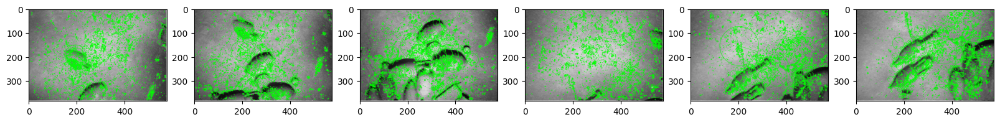

In [13]:
fig = plt.figure(figsize=(20,20))
i=1
for image in range(len(images_with_kpts)):
    fig.add_subplot(1, len(images_with_kpts), i)
    plt.imshow(images_with_kpts[image])
    i+=1

In [29]:
matches, keypoint_matches = FindMatches(keypoints, descriptors,flag = True)

In [31]:
h, mask = compute_homography(keypoints=keypoint_matches, flag=False)
print("H matrix: ",h)

H matrix:  [array([[ 1.00762431e+00,  4.88073441e-02, -1.14386356e+01],
       [-1.59217218e-02,  1.02738392e+00,  1.28809187e+02],
       [-5.80937236e-06,  1.35810261e-04,  1.00000000e+00]]), array([[ 9.86004031e-01,  4.91796994e-02, -2.59757527e+01],
       [-2.03746428e-03,  1.02733086e+00,  1.29102424e+02],
       [-9.49623941e-05,  1.91765024e-04,  1.00000000e+00]]), array([[ 1.13368877e+00, -3.71812972e+00, -2.59984273e+02],
       [-2.97607280e-01, -9.14181290e-01, -3.56501774e+02],
       [-1.31584780e-02, -8.48351945e-03,  1.00000000e+00]]), array([[ 9.98898406e-01,  4.51457749e-02, -1.33417017e+01],
       [-2.63167815e-02,  1.01144397e+00,  1.47846515e+02],
       [-1.55732383e-05,  1.50322214e-04,  1.00000000e+00]]), array([[ 9.05761939e-01,  2.03119643e-02,  7.60860177e+00],
       [-9.97308445e-03,  9.71309500e-01,  1.11176057e+02],
       [-1.22398808e-04,  7.38648266e-05,  1.00000000e+00]]), array([[-6.25424097e-01, -8.93249755e+00,  6.89793797e+02],
       [ 1.4888662

In [32]:
# Initialize translations
translations = np.array([0, 0])

# Iterate through the homography matrices, excluding the last two
for i in range(len(h) - 2):
    # Apply translations to the homography matrix
    h[i][0, 2] += translations[0]
    h[i][1, 2] += translations[1]

    # Chain the homography matrices together
    if i > 0:
        h[i] = np.dot(h[i], h[i - 1])


In [33]:
def calculate_odometry_noise(mask):
    match_count = np.count_nonzero(mask)

    noise_levels = {
        "low": (0.05, 0.05, 0.05),  # More confidence
        "medium": (0.2, 0.2, 0.15),  # Slightly higher uncertainty
        "high": (0.5, 0.5, 0.3),  # Significant uncertainty
        "max": (0.8, 0.8, 0.4)  # Maximum uncertainty
    }

    if match_count > 100:
        noise_key = "low"
    elif 50 < match_count <= 100:
        noise_key = "medium"
    elif 20 < match_count <= 50:
        noise_key = "high"
    else:
        noise_key = "max"

    noise_values = noise_levels[noise_key]
    return gtsam.noiseModel.Diagonal.Sigmas(gtsam.Point3(*noise_values))


# Prior noise with low uncertainty for the starting pose
PRIOR_NOISE = gtsam.noiseModel.Diagonal.Sigmas(gtsam.Point3(0.1, 0.1, 0.05))

# Create a nonlinear factor graph for SLAM
graph = gtsam.NonlinearFactorGraph()

# Add the prior factor for the initial pose with high confidence
initial_pose = gtsam.Pose2(0, 0, 0)
graph.add(gtsam.PriorFactorPose2(0, initial_pose, PRIOR_NOISE))

ransac_inliers = []  # This should be filled with valid RANSAC inlier data

# Calculate odometry noise dynamically based on inliers
ODOMETRY_NOISE = calculate_odometry_noise(ransac_inliers)

In [34]:
def getFactorPose(index, pts_src = img1_points_list, pts_dst = img2_points_list):
    global ransac_mask
    similarity_mat, ransac_mask = cv2.estimateAffinePartial2D(pts_dst[index],pts_src[index])
    if np.count_nonzero(ransac_mask) > 10:
        scale = np.sqrt(similarity_mat[0, 0]**2+similarity_mat[1, 0]**2)
        similarity_mat[:2, :2] /= scale
        affine_matrix = np.vstack((similarity_mat, [0, 0, 1]))
        return gtsam.Pose2(affine_matrix[0, -1], affine_matrix[1, -1],
                    np.arctan2(affine_matrix[1, 0], affine_matrix[0, 0]))
    return None

# Adapted from Zhiyong Zhang

In [35]:
initial_estimate = gtsam.Values()
initial_estimate.insert(0, gtsam.Pose2(0, 0, 0))

for i in range(len(h)-1):
    estimate = h[i]
    estimate[2][0], estimate[2][1] = 0,0
    s = np.sqrt(estimate[0,0]**2+estimate[1,0]**2)
    estimate[:2, :2] /= s
    total_affine_matrix = np.eye(3)
    EstimateInv = np.linalg.inv(estimate)
    estimate = EstimateInv.dot(total_affine_matrix)
    x,y, theta = estimate[0,2], estimate[1,2], np.arctan2(estimate[1, 0], estimate[0, 0])
    initial_estimate.insert(i+1, gtsam.Pose2(x,y,theta))


In [36]:
for img1_idx, img2_idx in itertools.combinations(range(len(NormalizedImages)), 2):
    # Check if images are sequential
    if img1_idx + 1 == img2_idx:
        # print(img1_idx, end=" ")
        pose_factor = getFactorPose(img1_idx)
        if pose_factor:
            noise_model = calculate_odometry_noise(mask[img1_idx])
            graph.add(gtsam.BetweenFactorPose2(img1_idx, img2_idx, pose_factor, noise_model))
    else:
        keypoints_pair = [keypoints[img1_idx], keypoints[img2_idx]]
        descriptors_pair = [descriptors[img1_idx], descriptors[img2_idx]]

        # Find matches and keypoint correspondences
        matches, keypoint_matches = FindMatches(keypoints_pair, descriptors_pair, flag=True)
        homography, ransac_mask = compute_homography(keypoints=keypoint_matches, flag=False)

        # Extract matched points from keypoint pairs
        img1_points = np.float32([kp[0] for kp in keypoint_matches])
        img2_points = np.float32([kp[1] for kp in keypoint_matches])

        # Calculate pose from matched points
        pose_factor = getFactorPose(0, img1_points, img2_points)
        if pose_factor:
            noise_model = calculate_odometry_noise(ransac_mask)
            graph.add(gtsam.BetweenFactorPose2(img1_idx, img2_idx, pose_factor, noise_model))

0 1 2 3 4 

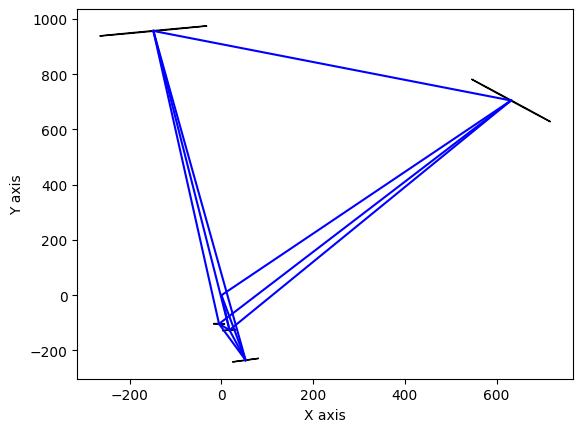

In [37]:
marginals = gtsam.Marginals(graph, initial_estimate)

for i in range(initial_estimate.size()):
    gtsam.utils.plot.plot_pose2(0, initial_estimate.atPose2(i), 0.5, marginals.marginalCovariance(i))

for i in range(graph.size())[1:]:
    k1, k2 = graph.at(i).keys()
    img1Pose = initial_estimate.atPose2(k1)
    img2Pose = initial_estimate.atPose2(k2)
    plt.plot([img1Pose.x(), img2Pose.x()], [img1Pose.y(), img2Pose.y()], color='blue')
plt.show()

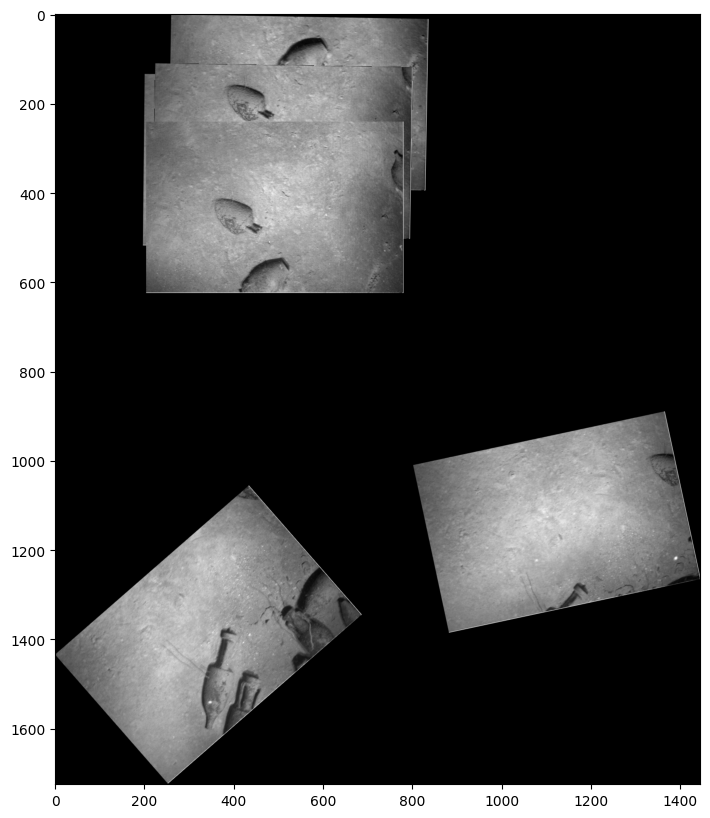

In [38]:
poses = gtsam.utilities.allPose2s(initial_estimate)
affineList = []
AffineOff = np.eye(3, dtype=np.float64)

for i in range(len(NormalizedImages)):
    TranslationMatrix = np.eye(3)
    pose = poses.atPose2(i)
    poseMatrix = pose.matrix()
    TranslationMatrix[:2, 2] -= np.array([im_w / 2, im_h / 2]).T
    affineList.append(poseMatrix.dot(TranslationMatrix))

affineList.reverse()
ImgPoints = [h.dot(np.array([0, 0, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([im_w - 1, 0, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([im_w - 1, im_h - 1, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([0, im_h - 1, 1]).T)[:-1] for h in affineList]
Min = np.floor(np.amin(ImgPoints, axis=0)).astype(np.int32)
Max = np.ceil(np.amax(ImgPoints, axis=0)).astype(np.int32)
Crop = tuple(Max - Min + 1)
AffineOff[0, -1] -= Min[0] if Min[0] < 0 else 0
AffineOff[1, -1] -= Min[1] if Min[1] < 0 else 0
Final = np.zeros((Crop[1], Crop[0], 3), np.uint8)
NormalizedImages.reverse()
for i in range(len(affineList)):
    img = NormalizedImages[i]
    h1 = affineList[i]
    WrappedImage = cv2.warpPerspective(img, AffineOff.dot(h1), Crop)
    Final = np.where(WrappedImage != 0, WrappedImage, Final)
plt.figure(figsize=(10,10))
plt.imshow(Final)


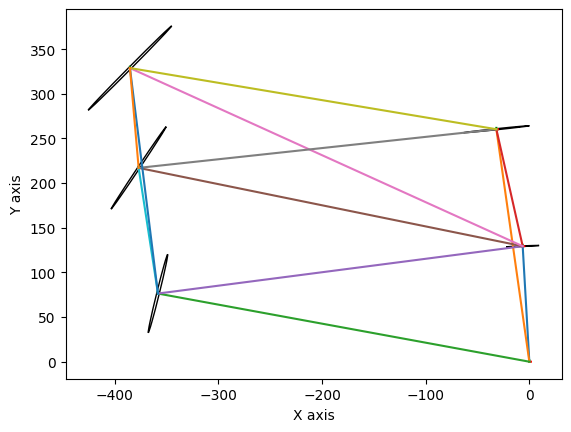

In [173]:
params = gtsam.LevenbergMarquardtParams()
optimizer = gtsam.LevenbergMarquardtOptimizer(graph, initial_estimate, params)

initial_estimate = optimizer.optimize()
marginals = gtsam.Marginals(graph, initial_estimate)

for i in range(initial_estimate.size()):
    gtsam.utils.plot.plot_pose2(0, initial_estimate.atPose2(i), 1.5, marginals.marginalCovariance(i))

for i in range(graph.size())[1:]:
    k1, k2 = graph.at(i).keys()
    img1Pose = initial_estimate.atPose2(k1)
    img2Pose = initial_estimate.atPose2(k2)
    plt.plot([img1Pose.x(), img2Pose.x()], [img1Pose.y(), img2Pose.y()])
plt.show()

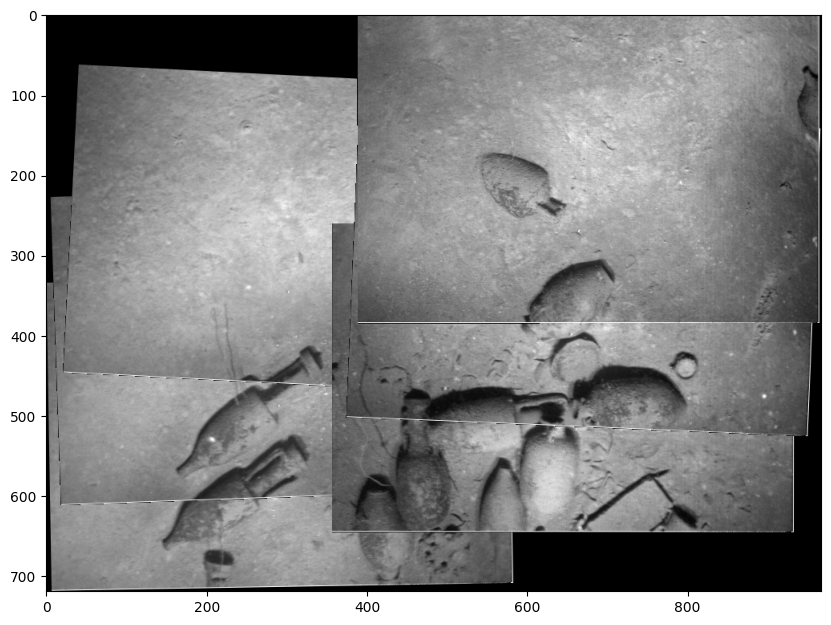

In [25]:
# Get all pose matrices from the initial estimate
poses = gtsam.utilities.allPose2s(initial_estimate)
affine_list = []
affine_offset = np.eye(3, dtype=np.float64)

# Construct affine transformations for all images
for i in range(len(NormalizedImages)):
    pose_matrix = poses.atPose2(i).matrix()
    translation_matrix = np.eye(3)
    translation_matrix[:2, 2] -= np.array([im_w / 2, im_h / 2])  # Adjust for image center offset
    affine_list.append(pose_matrix.dot(translation_matrix))

# Reverse the list for backward transformation
affine_list.reverse()

# Compute corner points in the warped coordinate system
corners = [
    [0, 0], [im_w - 1, 0], [im_w - 1, im_h - 1], [0, im_h - 1]
]
img_points = np.vstack([h.dot(np.array([x, y, 1]).T)[:-1] for h in affine_list for x, y in corners])

# Calculate the bounding box of the transformed images
min_coords = np.floor(np.amin(img_points, axis=0)).astype(np.int32)
max_coords = np.ceil(np.amax(img_points, axis=0)).astype(np.int32)
crop_size = tuple(max_coords - min_coords + 1)

# Adjust affine offset based on minimum coordinates
affine_offset[0, -1] -= min_coords[0] if min_coords[0] < 0 else 0
affine_offset[1, -1] -= min_coords[1] if min_coords[1] < 0 else 0

# Initialize the final composite image
final_image = np.zeros((crop_size[1], crop_size[0], 3), dtype=np.uint8)

# Apply affine transformations to each image and blend into the final image
for img, h_matrix in zip(NormalizedImages, affine_list):
    warped_img = cv2.warpPerspective(img, affine_offset.dot(h_matrix), crop_size)
    final_image = np.where(warped_img != 0, warped_img, final_image)  # Blend images

# Display the resulting composite image
plt.figure(figsize=(10, 10))
plt.imshow(final_image)
plt.show()

In the code, the noise levels are categorized into four ranges—low, medium, high, and maximum—based on the number of feature matches. These ranges adjust the covariance values to reflect the certainty or uncertainty in the image transformations. When the number of matches is greater than 100, the "low" noise level is applied (e.g., 0.05 for translation and rotation), indicating high confidence in the transformation. If the match count falls between 50 and 100, the noise level is set to "medium" (e.g., 0.2), indicating moderate uncertainty. For matches between 20 and 50, the noise level becomes "high" (e.g., 0.5), reflecting increased uncertainty. Finally, if the match count is below 20, the "max" noise level is chosen (e.g., 0.8), representing maximum uncertainty. This approach ensures that transformations with fewer matches, and thus higher uncertainty, have less influence on the final image alignment, while those with many matches, and more confidence, have a stronger impact.

In [9]:
directories = ['/content/sample_data/Images_29/second_column/',
               '/content/sample_data/Images_29/third_column/',
               '/content/sample_data/Images_29/fourth_column/',
               '/content/sample_data/Images_29/first_column/'
]



In [10]:
Images_29 = []
for path in directories:
    files = sorted(filter(os.path.isfile, glob.glob(path + '*')))
    for img in files:
        Images_29.append(cv2.imread(img))

print(len(Images_29))

28


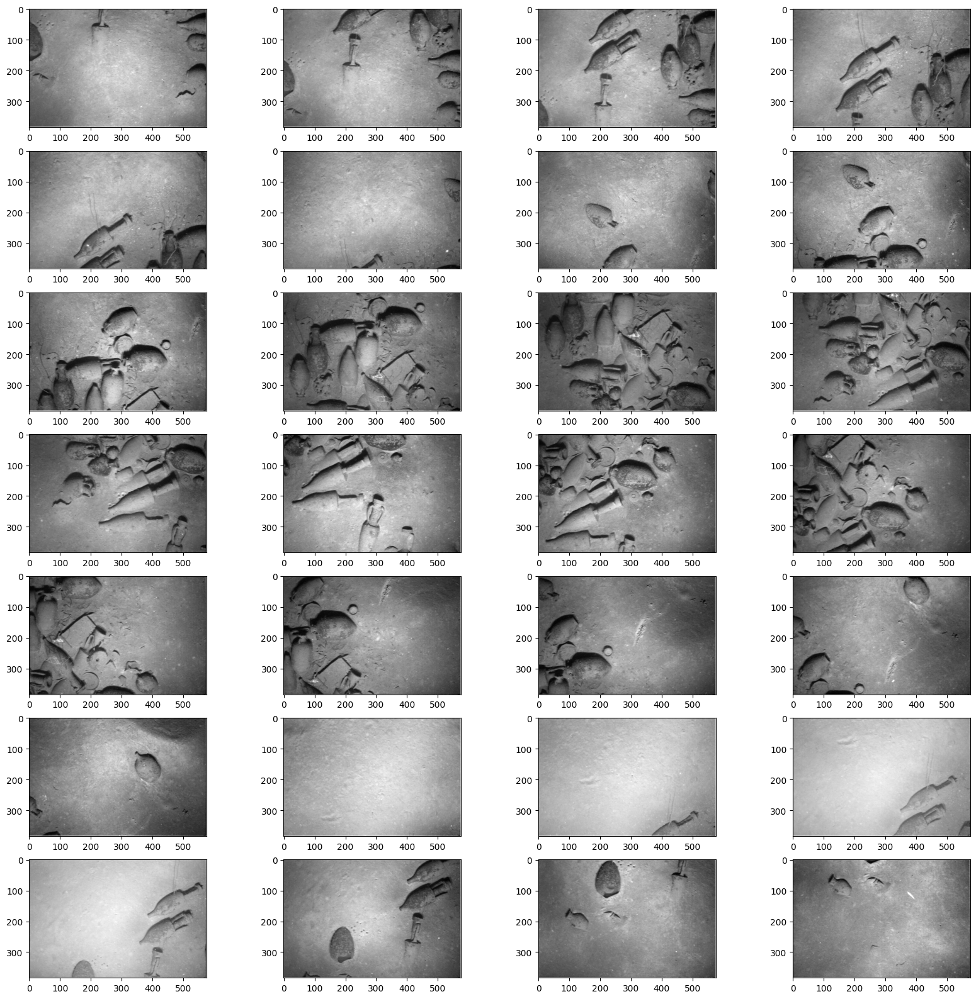

In [11]:
fig = plt.figure(figsize=(20,20))
i=1
for image in range(len(Images_29)):
    fig.add_subplot(7, int(len(Images_29)/7), i)
    plt.imshow(Images_29[image])
    i+=1

In [12]:
NormalizedImages = [cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX) for img in Images_29]
grayImages = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in NormalizedImages]
im_h, im_w = grayImages[0].shape
sift = cv2.SIFT_create(nfeatures=7000, nOctaveLayers=12, contrastThreshold=0.025, sigma=1.6)

In [13]:
keypoints = []
descriptors = []
ImgWithKeypoints = []

for gr in grayImages:
    kpts, descs = sift.detectAndCompute(gr, None)

    bimg = np.zeros((im_h, im_w))
    response = np.array([keypoint.response for keypoint in kpts])
    mask = np.flip(np.argsort(response))
    points = np.rint([keypoint.pt for keypoint in kpts])[mask].astype(int)

    mask_non = []
    for i in range(len(points)):
        pt = points[i]
        if bimg[pt[1], pt[0]] == 0:
            mask_non.append(mask[i])
            cv2.circle(bimg, (pt[0], pt[1]), 2, 255, -1)

    imgWKpts = cv2.drawKeypoints(gr, kpts, gr, color=[0, 255, 0], flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    keypoints.append(np.array(kpts)[mask_non])
    descriptors.append(np.array(descs)[mask_non])
    ImgWithKeypoints.append(imgWKpts)

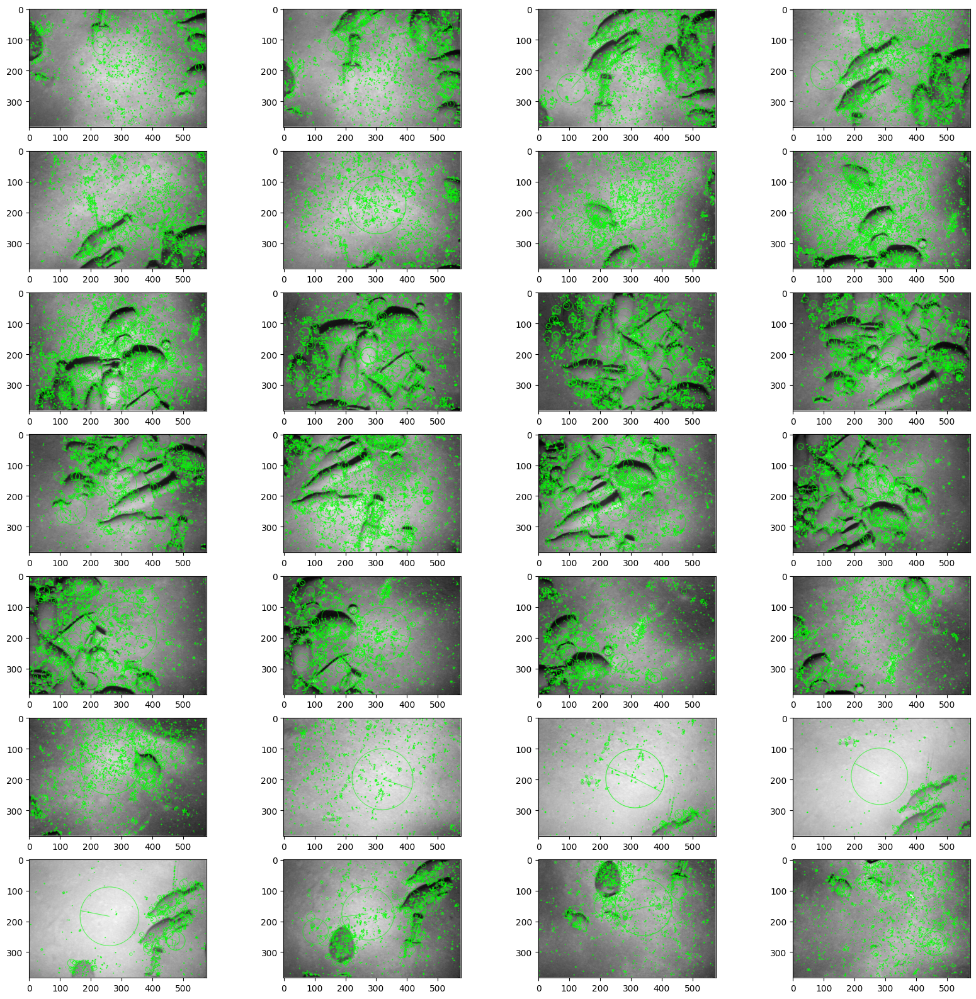

In [14]:
fig = plt.figure(figsize=(20,20))
i=1
for image in range(len(ImgWithKeypoints)):
    fig.add_subplot(7, np.ceil(len(Images_29)/7), i)
    plt.imshow(ImgWithKeypoints[image])
    i+=1

In [15]:
matches, keypoint_matches = FindMatches(keypoints, descriptors,flag = True)

In [16]:
h, mask = compute_homography(keypoints=keypoint_matches, flag=False)
print("H matrix: ",h)

H matrix:  [array([[ 9.88867395e-01, -5.65674094e-02,  1.86198958e+01],
       [ 3.24353461e-02,  9.33433106e-01, -1.21960300e+02],
       [ 3.83213112e-05, -1.71468946e-04,  1.00000000e+00]]), array([[ 9.79183735e-01, -5.28274368e-02,  2.17920070e+01],
       [ 2.23039718e-02,  9.18004375e-01, -1.16133761e+02],
       [ 2.08778536e-05, -1.60429219e-04,  1.00000000e+00]]), array([[ 9.71336168e-01, -3.93263163e-02,  2.02768792e+01],
       [ 1.00902336e-02,  9.91578855e-01, -1.31326308e+02],
       [ 9.18935845e-06, -1.36187735e-04,  1.00000000e+00]]), array([[ 9.93349910e-01, -3.95573676e-02,  1.64247735e+01],
       [ 1.45393648e-02,  9.92880821e-01, -1.19051693e+02],
       [ 2.22131086e-05, -1.15865088e-04,  1.00000000e+00]]), array([[ 9.83017625e-01, -4.89421365e-02,  1.93971284e+01],
       [ 1.06877225e-02,  1.00679852e+00, -1.45109169e+02],
       [ 1.70608885e-05, -1.50154221e-04,  1.00000000e+00]]), array([[ 1.21765850e+00, -7.31519232e-02,  3.66279659e+02],
       [ 3.4215578

In [17]:
# Initialize translations
translations = np.array([0, 0])

# Iterate through the homography matrices, excluding the last two
for i in range(len(h) - 2):
    # Apply translations to the homography matrix
    h[i][0, 2] += translations[0]
    h[i][1, 2] += translations[1]

    # Chain the homography matrices together
    if i > 0:
        h[i] = np.dot(h[i], h[i - 1])


In [18]:
PRIOR_NOISE = gtsam.noiseModel.Diagonal.Sigmas(gtsam.Point3(0.1, 0.1, 0.05))
# ODOMETRY_NOISE = gtsam.noiseModel.Diagonal.Sigmas(gtsam.Point3(0.2, 0.2, 0.1))
graph = gtsam.NonlinearFactorGraph()
graph.add(gtsam.PriorFactorPose2(0, gtsam.Pose2(0, 0, 0), PRIOR_NOISE))

ransac_mask = []


# Code Insipired by Zhang

In [19]:
initial_estimate = gtsam.Values()
initial_estimate.insert(0, gtsam.Pose2(0, 0, 0))

for i in range(len(h)-1):
    estimate = h[i]
    estimate[2][0], estimate[2][1] = 0,0
    s = np.sqrt(estimate[0,0]**2+estimate[1,0]**2) # adapted from ZZ
    estimate[:2, :2] /= s
    total_affine_matrix = np.eye(3)
    EstimateInv = np.linalg.inv(estimate)
    estimate = EstimateInv.dot(total_affine_matrix)
    x,y, theta = estimate[0,2], estimate[1,2], np.arctan2(estimate[1, 0], estimate[0, 0])
    initial_estimate.insert(i+1, gtsam.Pose2(x,y,theta))


In [20]:
# Iterate through image pairs
for img1_idx, img2_idx in itertools.combinations(range(len(NormalizedImages)), 2):
    if img1_idx + 1 == img2_idx:  # Check for sequential images
        # print(img1_idx, end=" ")
        pose_factor = getFactorPose(img1_idx)
        if pose_factor:
            noise_model = calculate_odometry_noise(mask[img1_idx])
            graph.add(gtsam.BetweenFactorPose2(img1_idx, img2_idx, pose_factor, noise_model))
    else:  # Non-sequential image pairs
        keypoints_pair = [keypoints[img1_idx], keypoints[img2_idx]]
        descriptors_pair = [descriptors[img1_idx], descriptors[img2_idx]]

        # Find keypoint matches and calculate homography
        matches, keypoint_matches = FindMatches(keypoints_pair, descriptors_pair, flag=True)
        homography, ransac_mask = compute_homography(keypoints=keypoint_matches, flag=False)

        # Extract matching points
        img1_points = np.float32([kp[0] for kp in keypoint_matches])
        img2_points = np.float32([kp[1] for kp in keypoint_matches])

        # Compute pose factor
        pose_factor = getFactorPose(0, img1_points, img2_points)
        if pose_factor:
            noise_model = calculate_odometry_noise(ransac_mask)
            graph.add(gtsam.BetweenFactorPose2(img1_idx, img2_idx, pose_factor, noise_model))


0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 

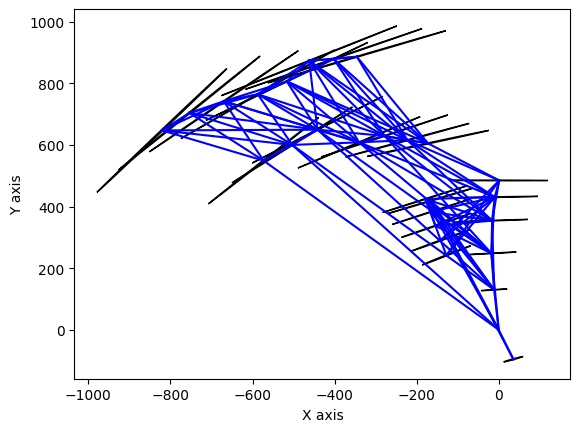

In [21]:
marginals = gtsam.Marginals(graph, initial_estimate)

for i in range(initial_estimate.size()):
    gtsam.utils.plot.plot_pose2(0, initial_estimate.atPose2(i), 0.5, marginals.marginalCovariance(i))

for i in range(graph.size())[1:]:
    k1, k2 = graph.at(i).keys()
    img1Pose = initial_estimate.atPose2(k1)
    img2Pose = initial_estimate.atPose2(k2)
    plt.plot([img1Pose.x(), img2Pose.x()], [img1Pose.y(), img2Pose.y()], color='blue')
plt.show()

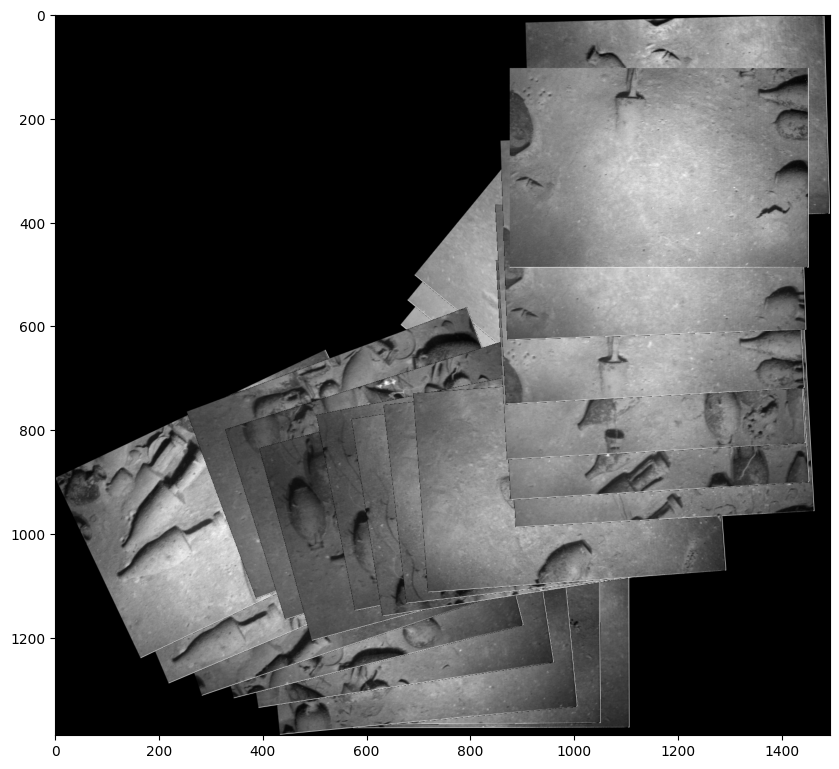

In [24]:
poses = gtsam.utilities.allPose2s(initial_estimate)
affineList = []
AffineOff = np.eye(3, dtype=np.float64)

for i in range(len(NormalizedImages)):
    TranslationMatrix = np.eye(3)
    pose = poses.atPose2(i)
    poseMatrix = pose.matrix()
    TranslationMatrix[:2, 2] -= np.array([im_w / 2, im_h / 2]).T
    affineList.append(poseMatrix.dot(TranslationMatrix))

affineList.reverse()
ImgPoints = [h.dot(np.array([0, 0, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([im_w - 1, 0, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([im_w - 1, im_h - 1, 1]).T)[:-1] for h in affineList] + [h.dot(np.array([0, im_h - 1, 1]).T)[:-1] for h in affineList]
Min = np.floor(np.amin(ImgPoints, axis=0)).astype(np.int32)
Max = np.ceil(np.amax(ImgPoints, axis=0)).astype(np.int32)
Crop = tuple(Max - Min + 1)
AffineOff[0, -1] -= Min[0] if Min[0] < 0 else 0
AffineOff[1, -1] -= Min[1] if Min[1] < 0 else 0
Final = np.zeros((Crop[1], Crop[0], 3), np.uint8)
NormalizedImages.reverse()
for i in range(len(affineList)):
    img = NormalizedImages[i]
    h1 = affineList[i]
    WrappedImage = cv2.warpPerspective(img, AffineOff.dot(h1), Crop)
    Final = np.where(WrappedImage != 0, WrappedImage, Final)
plt.figure(figsize=(10,10))
plt.imshow(Final)


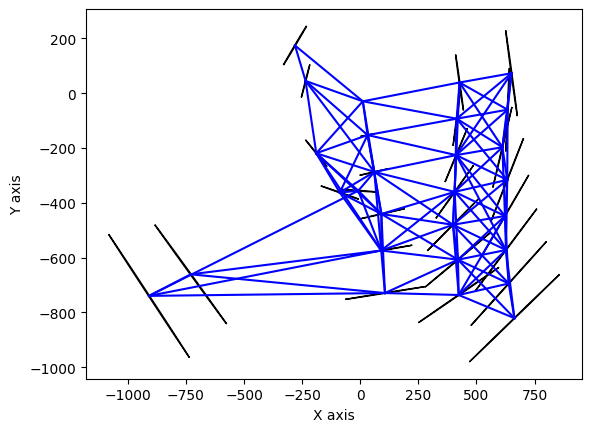

In [23]:
# Set up Levenberg-Marquardt optimizer with default parameters
params = gtsam.LevenbergMarquardtParams()
optimizer = gtsam.LevenbergMarquardtOptimizer(graph, initial_estimate, params)

# Perform optimization
optimized_estimate = optimizer.optimize()

# Calculate marginals (uncertainties) for the optimized poses
marginals = gtsam.Marginals(graph, optimized_estimate)

# Plot each pose with its covariance
for i in range(optimized_estimate.size()):
    pose = optimized_estimate.atPose2(i)
    covariance = marginals.marginalCovariance(i)
    gtsam.utils.plot.plot_pose2(0, pose, 0.5, covariance)  # Plot pose with covariance

# Plot lines connecting poses
for i in range(1, graph.size()):
    k1, k2 = graph.at(i).keys()  # Get the keys (indices) for the connected poses
    img1_pose = optimized_estimate.atPose2(k1)
    img2_pose = optimized_estimate.atPose2(k2)
    plt.plot([img1_pose.x(), img2_pose.x()], [img1_pose.y(), img2_pose.y()], color='blue')  # Plot line connecting poses

# Show the plot
plt.show()


<ipython-input-40-00d453da1ed9>:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,10))


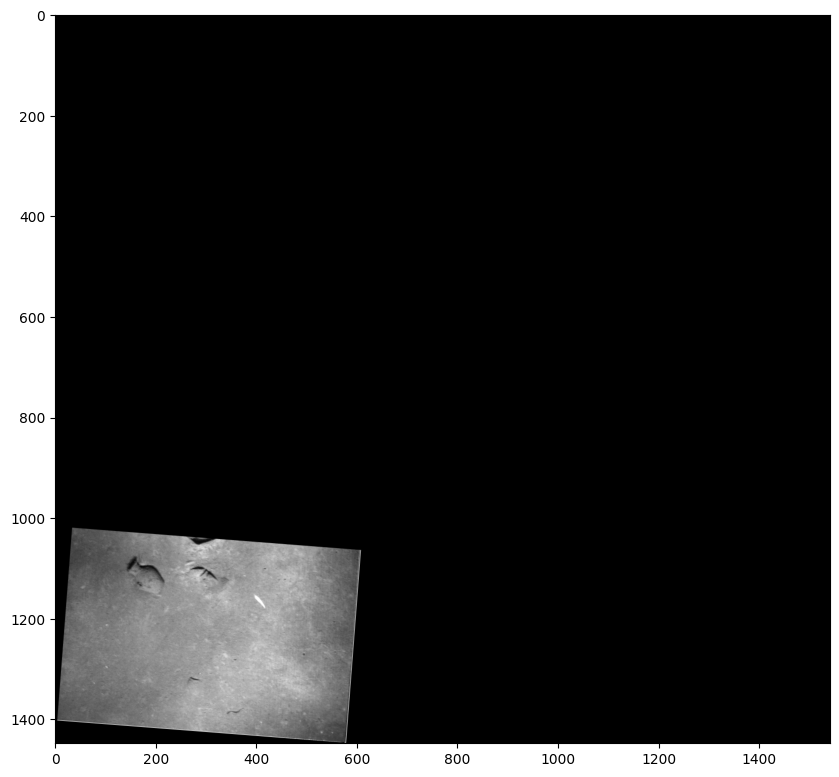

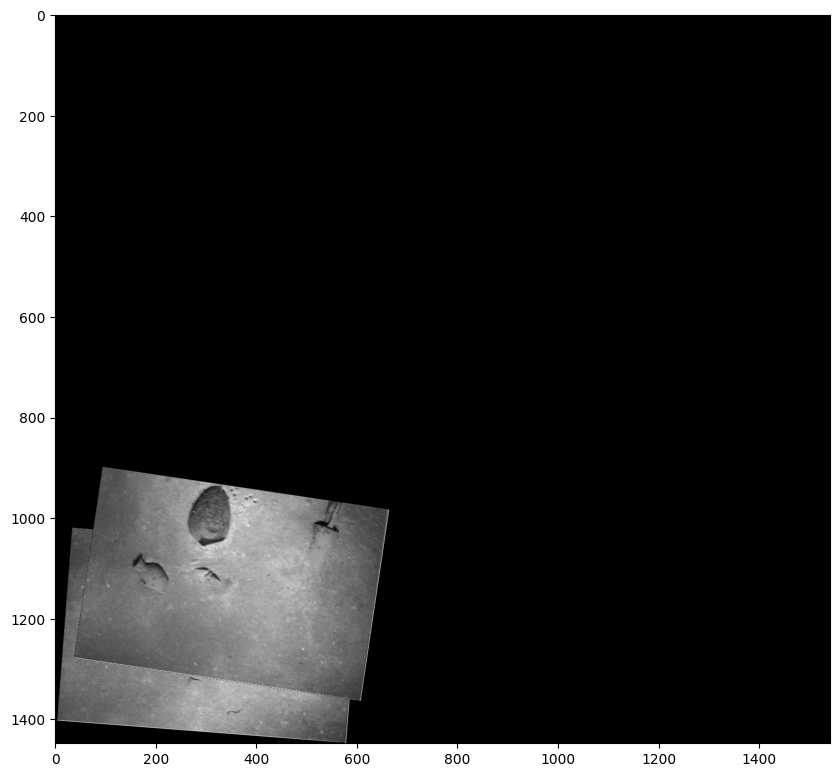

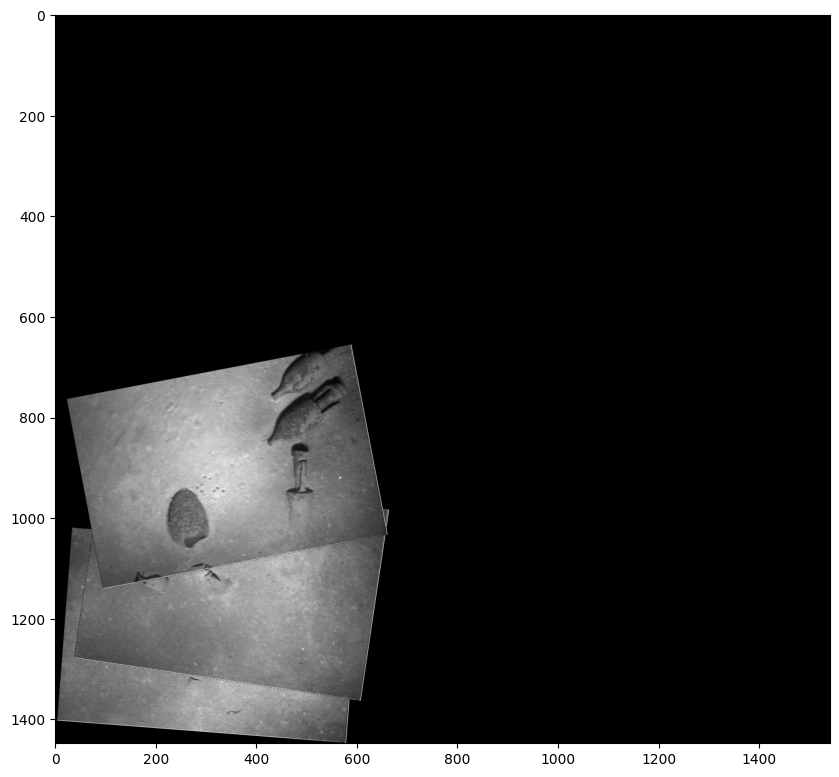

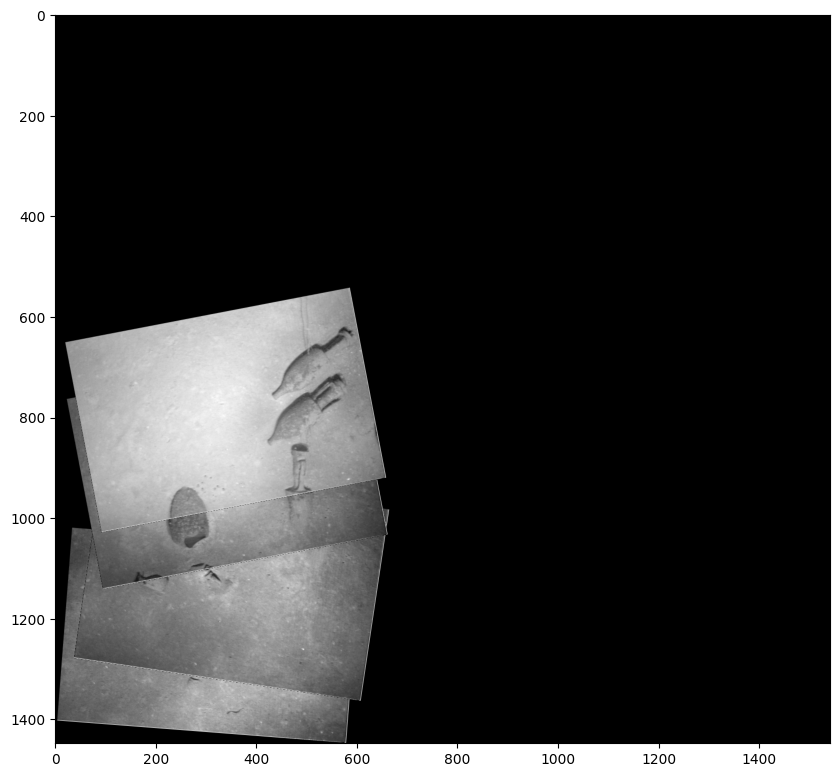

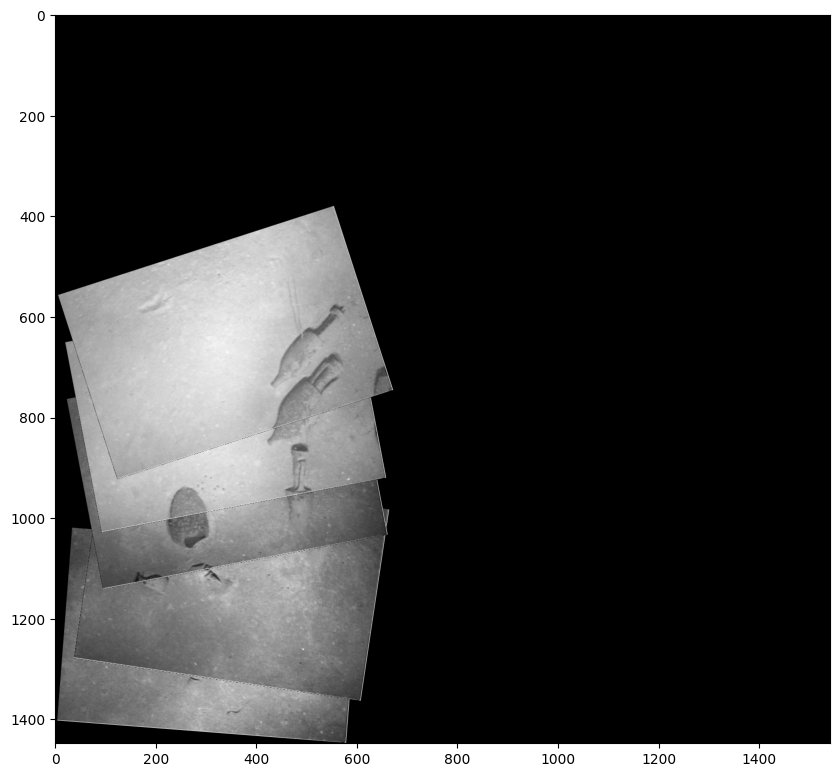

...

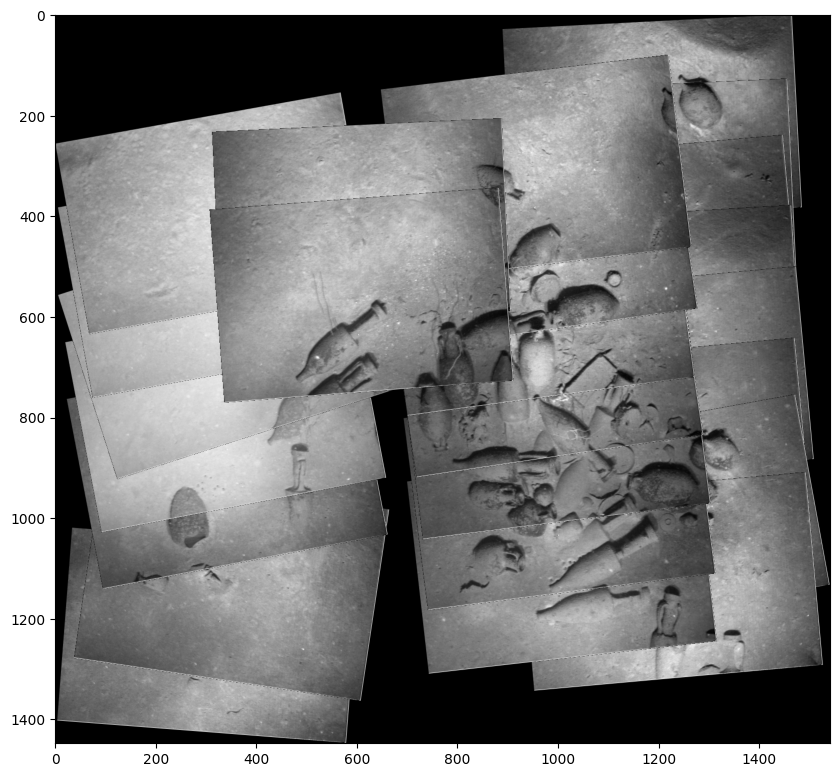

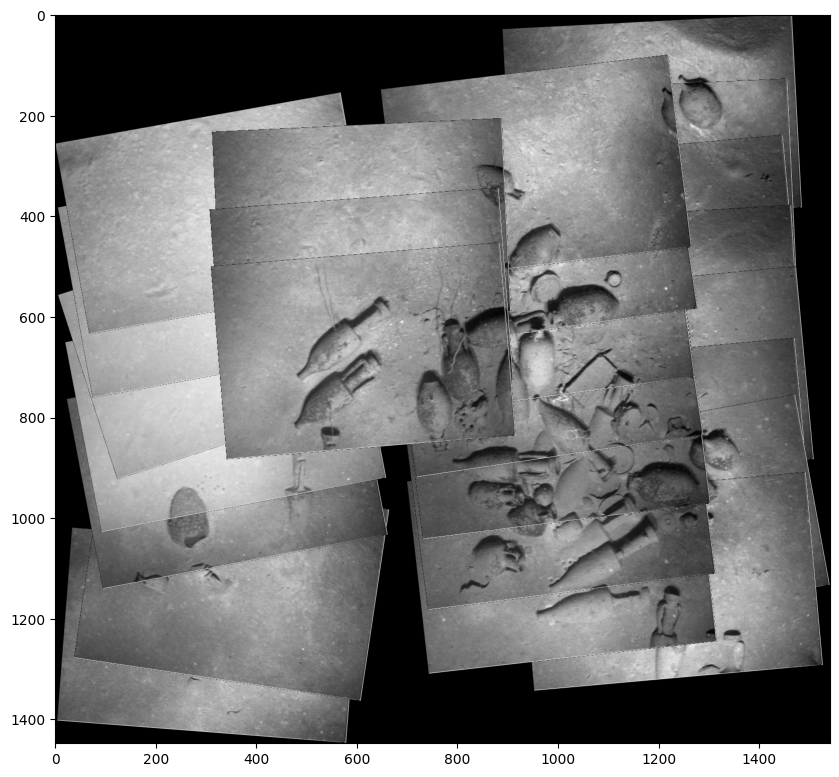

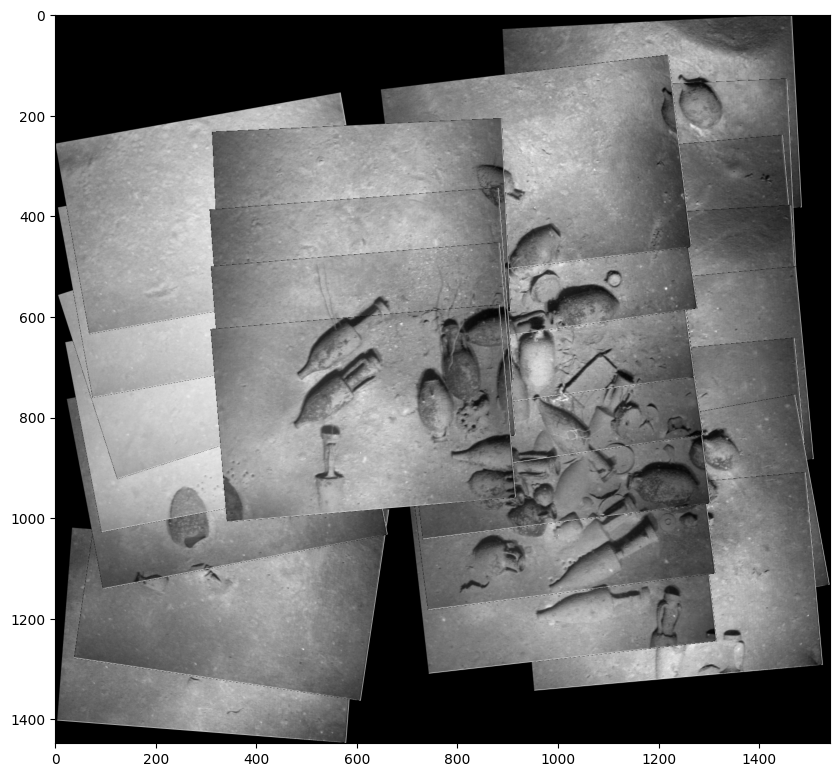

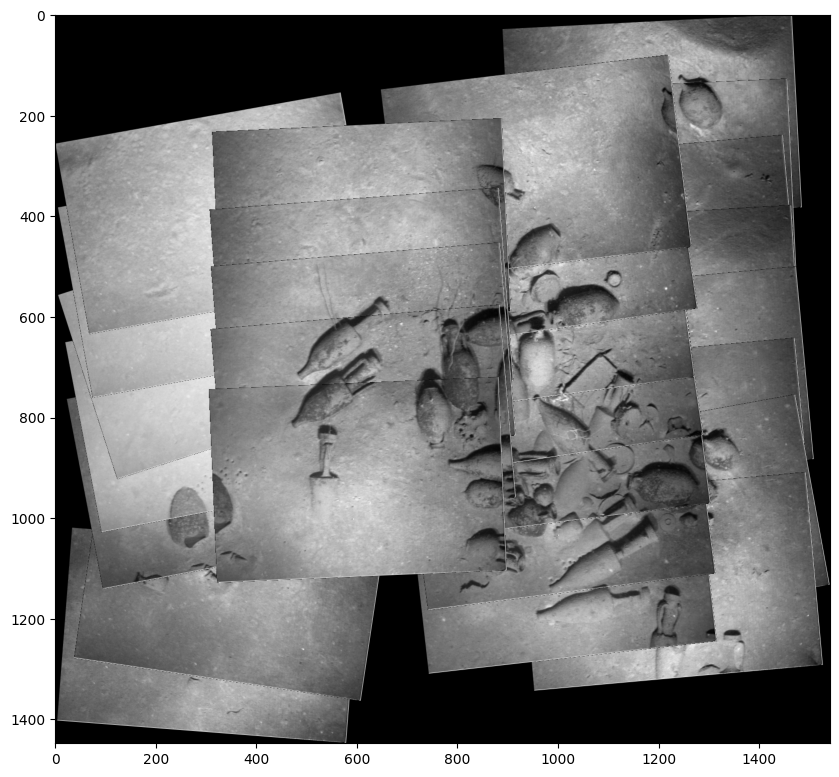

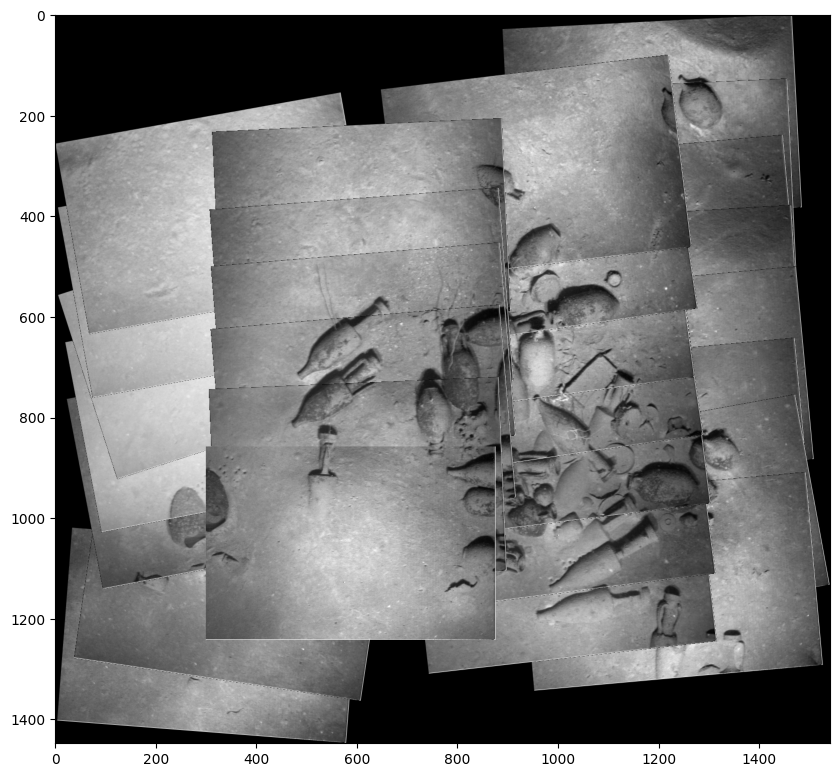

In [40]:
# Retrieve all poses from the initial estimate
poses = gtsam.utilities.allPose2s(initial_estimate)

# Initialize affine transformations and offset
affine_list = []
affine_offset = np.eye(3, dtype=np.float64)

# Calculate affine transformations for each image
for i in range(len(NormalizedImages)):
    translation_matrix = np.eye(3)
    pose = poses.atPose2(i).matrix()  # Extract the pose matrix
    translation_matrix[:2, 2] -= np.array([im_w / 2, im_h / 2])  # Adjust translation by image dimensions
    affine_list.append(pose.dot(translation_matrix))

# Reverse the list to process the transformations in the correct order
affine_list.reverse()

# Compute the image corner points after applying affine transformations
img_points = []
for h in affine_list:
    corners = [
        h.dot(np.array([0, 0, 1]).T)[:-1],
        h.dot(np.array([im_w - 1, 0, 1]).T)[:-1],
        h.dot(np.array([im_w - 1, im_h - 1, 1]).T)[:-1],
        h.dot(np.array([0, im_h - 1, 1]).T)[:-1]
    ]
    img_points.extend(corners)

# Calculate the bounding box for the final image
min_coords = np.floor(np.amin(img_points, axis=0)).astype(np.int32)
max_coords = np.ceil(np.amax(img_points, axis=0)).astype(np.int32)
crop_size = tuple(max_coords - min_coords + 1)

# Adjust the affine offset matrix based on minimum coordinates
affine_offset[0, -1] -= min_coords[0] if min_coords[0] < 0 else 0
affine_offset[1, -1] -= min_coords[1] if min_coords[1] < 0 else 0

# Create an empty final image with the calculated crop size
final_image = np.zeros((crop_size[1], crop_size[0], 3), np.uint8)

# Warp each image using the calculated affine transformations
for i, h in enumerate(affine_list):
    wrapped_img = cv2.warpPerspective(NormalizedImages[i], affine_offset.dot(h), crop_size)
    final_image = np.where(wrapped_img != 0, wrapped_img, final_image)  # Overlay non-zero pixels onto final image

# Display the final stitched image
plt.figure(figsize=(10, 10))
plt.imshow(final_image)
plt.show()
